In [1]:
!git clone https://github.com/jagar2/Summer_2020_MAT-395-495_Scientific-Data-Analysis-and-Computing.git
%cd '/content/Summer_2020_MAT-395-495_Scientific-Data-Analysis-and-Computing/lectures/5_Image_Analysis'

fatal: destination path 'Summer_2020_MAT-395-495_Scientific-Data-Analysis-and-Computing' already exists and is not an empty directory.
/content/Summer_2020_MAT-395-495_Scientific-Data-Analysis-and-Computing/lectures/5_Image_Analysis


In [ ]:
# This just checks to make sure you have the right packages installed
%run check_setup.py

[✓] scikit-image  0.16.2
[✓] numpy         1.18.5
[✓] scipy         1.4.1
[✓] matplotlib    3.2.2
[✓] notebook      5.2.2
[✓] scikit-learn  0.22.2.post1


In [2]:
# Magic command to make plotting inline
%matplotlib inline

# sets the figure format
%config InlineBackend.figure_format = 'retina'

# Images are numpy arrays

Images are represented in ``scikit-image`` using standard ``numpy`` arrays.  This allows maximum inter-operability with other libraries in the scientific Python ecosystem, such as ``matplotlib`` and ``scipy``.

Let's see how to build a grayscale image as a 2D array:

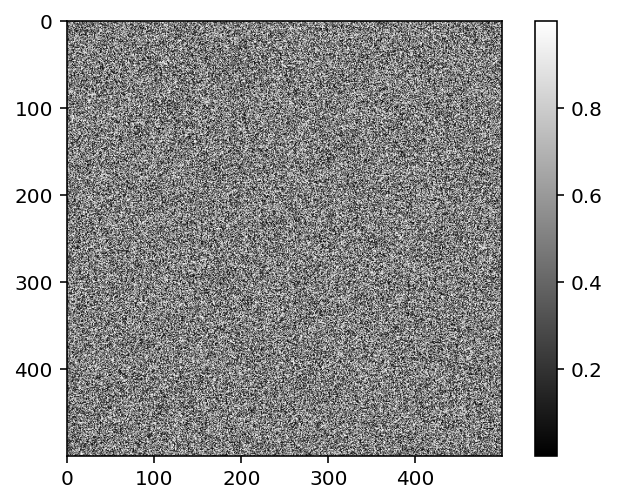

In [3]:
import numpy as np
import matplotlib.pyplot as plt

random_image = np.random.random([500,500])

plt.imshow(random_image, cmap='gray')

plt.colorbar()

In [4]:
random_image.shape

(500, 500)

type <class 'numpy.ndarray'>
dtype uint8
shape (303, 384)


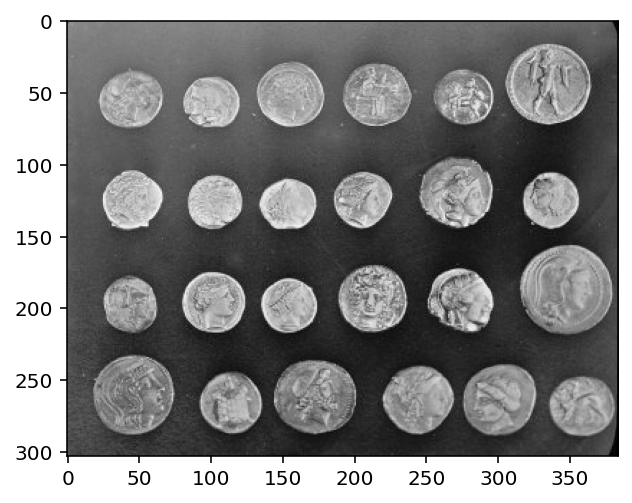

In [5]:
from skimage import data

coins = data.coins()

print('type', type(coins))
print('dtype', coins.dtype)
print('shape', coins.shape)

plt.imshow(coins, cmap = 'gray')

shape: (300, 451, 3)
min/max 0 231


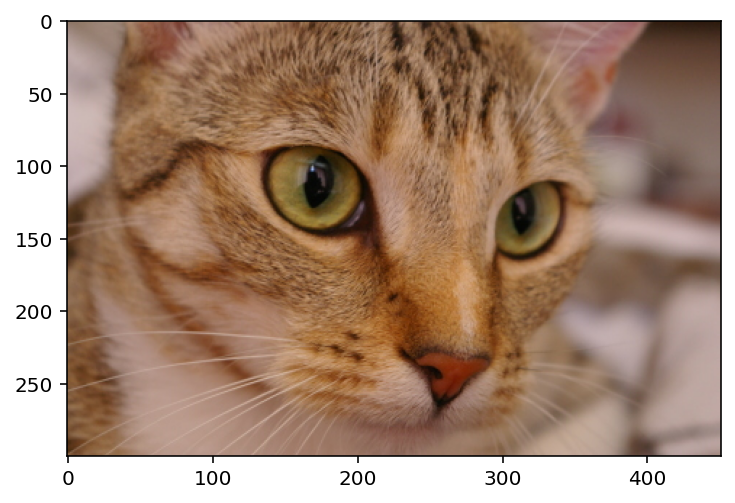

In [6]:
cat = data.chelsea()
print("shape:", cat.shape)
print('min/max', cat.min(), cat.max())

plt.imshow(cat)

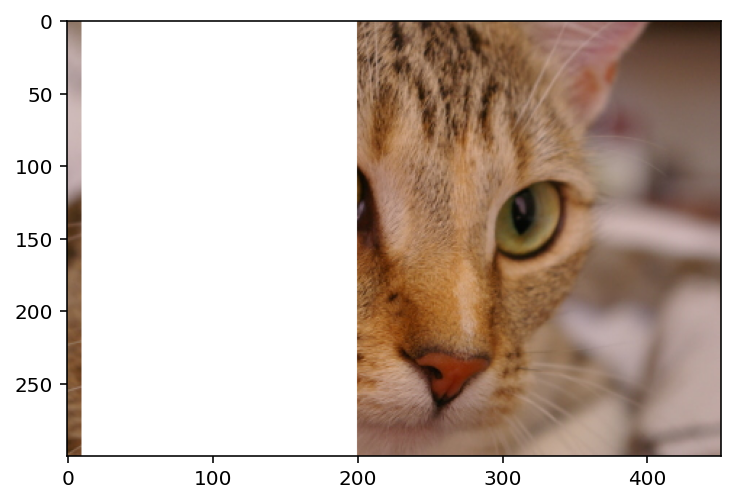

In [7]:
# starts at x,y=10 to x,y = 110 red box
cat[:, 10:200, :] = [255, 255, 255]

plt.imshow(cat)



### Other shapes, and their meanings

|Image type|Coordinates|
|:---|:---|
|2D grayscale|(row, column)|
|2D multichannel|(row, column, channel)|
|3D grayscale (or volumetric) |(plane, row, column)|
|3D multichannel|(plane, row, column, channel)|

## Displaying images using matplotlib

In [8]:
from skimage import data

img0 = data.chelsea()
img1 = data.rocket()

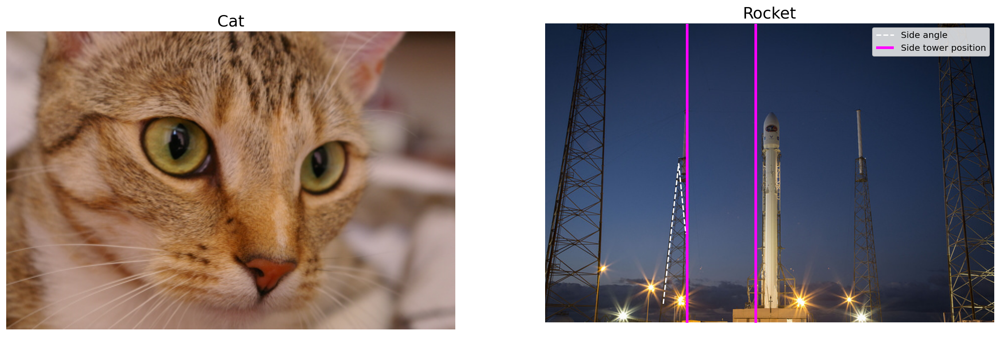

In [9]:
import matplotlib.pyplot as plt

f, (ax0, ax1) = plt.subplots(1, 2, figsize=(20, 10))

ax0.imshow(img0)
ax0.set_title('Cat', fontsize=18)
ax0.axis('off')

ax1.imshow(img1)
ax1.set_title('Rocket', fontsize=18)
ax1.set_xlabel(r'Launching position $\alpha=320$')
ax1.axis('off')

ax1.vlines([202, 300], 0, img1.shape[0], colors='magenta', linewidth=3, label='Side tower position')
ax1.plot([168, 190, 200], [400, 200, 300], color='white', linestyle='--', label='Side angle')

ax1.legend();

## Data types and image values

In literature, one finds different conventions for representing image values:

```
  0 - 255   where  0 is black, 255 is white
  0 - 1     where  0 is black, 1 is white
```

``scikit-image`` supports both conventions--the choice is determined by the
data-type of the array.

E.g., here, I generate two valid images:

linear0: float64 0.0 1.0
linear1: float64 0.0 255.0


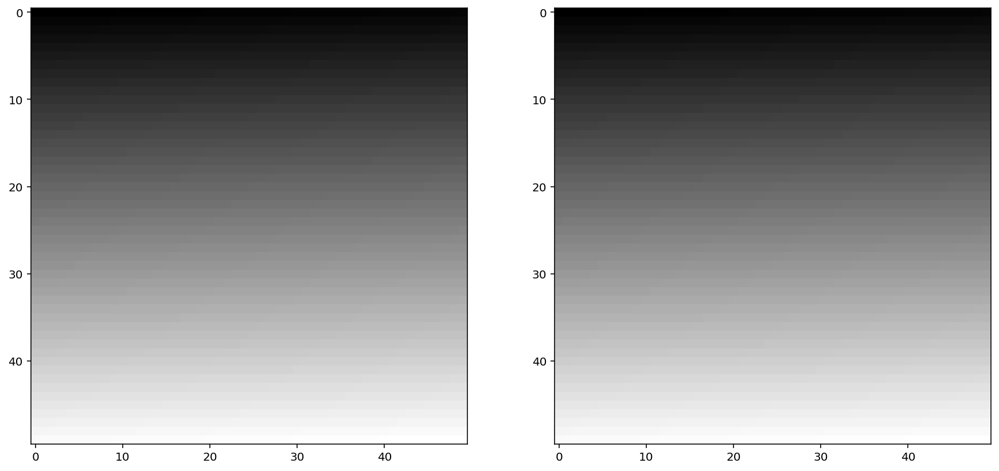

In [10]:
import matplotlib.pyplot as plt
import numpy as np

linear0 = np.linspace(0, 1, 2500).reshape(50,50)
linear1 = linear0*255 #np.linspace(0, 255, 2500).reshape(50,50)


print("linear0:", linear0.dtype, linear0.min(), linear0.max())
print("linear1:", linear1.dtype, linear1.min(), linear1.max())


fig, (ax0, ax1) = plt.subplots(1,2, figsize=(15,15))

ax0.imshow(linear0, 'gray')
ax1.imshow(linear1, 'gray')

## Image I/O


Mostly, we won't be using input images from the scikit-image example data sets.  Those images are typically stored in JPEG or PNG format.  Since scikit-image operates on NumPy arrays, *any* image reader library that provides arrays will do.  Options include imageio, matplotlib, pillow, etc.

scikit-image conveniently wraps many of these in the `io` submodule, and will use whichever of the libraries mentioned above are installed:

<class 'numpy.ndarray'>
uint8
(300, 225, 3)
0 255


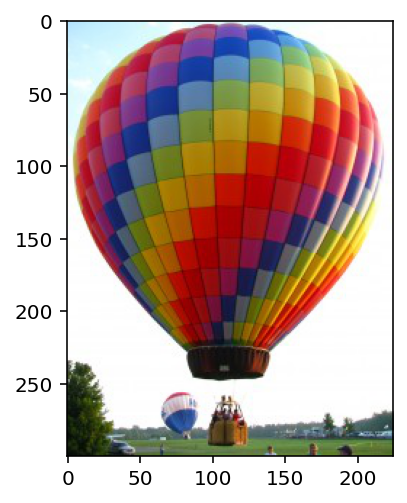

In [11]:
from skimage import io

image = io.imread('./images/balloon.jpg')

print(type(image))
print(image.dtype)
print(image.shape)
print(image.min(), image.max())

plt.imshow(image)

In [12]:
ic = io.ImageCollection('./images/*.png:./images/*.jpg')

print('Type:', type(ic))

ic.files

Type: <class 'skimage.io.collection.ImageCollection'>


['./images/Bells-Beach.jpg',
 './images/balloon.jpg',
 './images/bubbles.jpg',
 './images/censure_example.png',
 './images/chapel_floor.png',
 './images/chromosomes.jpg',
 './images/clock_motion.png',
 './images/color-wheel.jpg',
 './images/credit_card.jpg',
 './images/cycle_spin.png',
 './images/fingers.png',
 './images/forest.jpg',
 './images/greenscreen.jpg',
 './images/hand-coin.jpg',
 './images/microarray.jpg',
 './images/mm.jpg',
 './images/mona_lisa.jpg',
 './images/mpl_hist.png',
 './images/round_pill.jpg',
 './images/snakes.png',
 './images/spice_1.jpg',
 './images/spices.jpg',
 './images/stefan.jpg',
 './images/superprom_prev.jpg',
 './images/terminator_vision.png',
 './images/zebrafish-spinal-cord-color.png',
 './images/zebrafish-spinal-cord.png']

In [13]:
len(ic) // 3

9

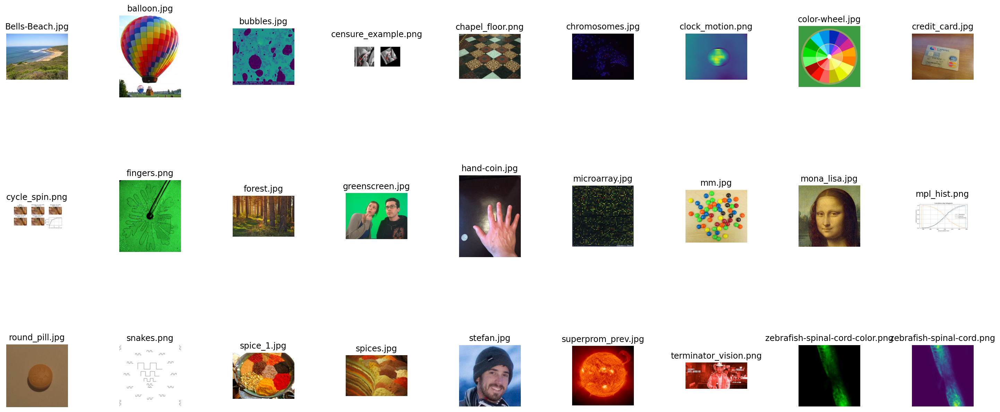

In [14]:
import os

f, axes = plt.subplots(nrows=3, ncols = len(ic) // 3, figsize = (20, 10))

axes = axes.ravel()

for ax in axes: 
  ax.axis('off')


# enumerate
# os.path.basename()

for i, images in enumerate(ic):
  axes[i].imshow(images)
  axes[i].set_title(os.path.basename(ic.files[i]))

plt.tight_layout()

AxesSubplot(0.125,0.125;0.227941x0.755) (300, 300)
AxesSubplot(0.398529,0.125;0.227941x0.755) (300, 300)
AxesSubplot(0.672059,0.125;0.227941x0.755) (300, 300)


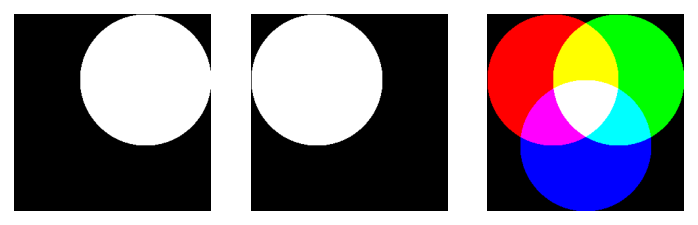

In [15]:
from skimage import draw

red = np.zeros((300,300))
green = np.zeros((300,300))
blue = np.zeros((300,300))

r, c = draw.circle(100,200,100)
red[r, c] = 1

r, c = draw.circle(100,100,100)
green[r, c] = 1

r, c = draw.circle(200,150,100)
blue[r, c] = 1

f, axes = plt.subplots(1,3)

for (ax, channel) in zip(axes, [red, green, blue]):
  print(ax, channel.shape)

  ax.imshow(channel, cmap = 'gray')
  ax.axis('off')

#np.stack
plt.imshow(np.stack([green, red , blue], axis=-1))

# Image filtering

Filtering is one of the most basic and common image operations in image processing. You can filter an image to remove noise or to enhance features; the filtered image could be the desired result or just a preprocessing step. Regardless, filtering is an important topic to understand.

In [ ]:
plt.rcParams['image.cmap'] = 'gray'

The "local" in local filtering simply means that a pixel is adjusted by values in some surrounding neighborhood. These surrounding elements are identified or weighted based on a "footprint", "structuring element", or "kernel".

Let's go to back to basics and look at a 1D step-signal

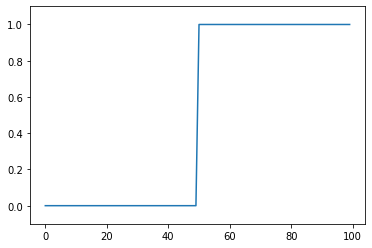

In [ ]:
step_signal = np.zeros(100)
step_signal[50:] = 1


f, ax = plt.subplots()

ax.plot(step_signal)
ax.margins(y=0.1)

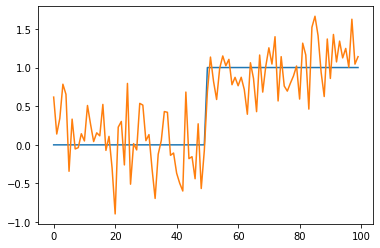

In [ ]:
np.random.seed(0)

noisy_signal = (step_signal + np.random.normal(0, 0.35, step_signal.shape))

f, ax = plt.subplots()

ax.plot(step_signal)
ax.plot(noisy_signal)

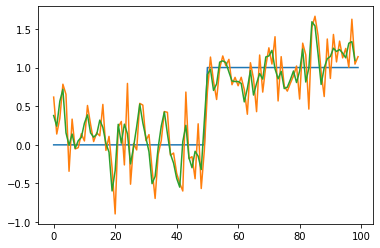

In [ ]:
smooth_signal = (noisy_signal[:-1] + noisy_signal[1:]) / 2.0

f, ax = plt.subplots()

ax.plot(step_signal)
ax.plot(noisy_signal)
ax.plot(smooth_signal)

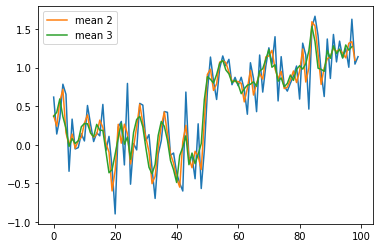

In [ ]:
smooth_signal_3 = (noisy_signal[:-2] + noisy_signal[1:-1]+ noisy_signal[2:]) / 3

f, ax = plt.subplots()

#ax.plot(step_signal)
ax.plot(noisy_signal)
ax.plot(smooth_signal, label = 'mean 2')
ax.plot(smooth_signal_3, label = 'mean 3')

ax.legend(loc='upper left')

For averages of more points, the expression keeps getting hairier. And you have to worry more about what's going on in the margins. Is there a better way?

It turns out there is. This same concept, nearest-neighbor averages, can be expressed as a *convolution* with an *averaging kernel*. Note that the operation we did with `smooth_signal3` can be expressed as follows:

* Create an output array called `smooth_signal3`, of the same length as `noisy_signal`.
* At each element in `smooth_signal3` starting at point 1, and ending at point -2, place the average of the sum of: 1/3 of the element to the left of it in `noisy_signal`, 1/3 of the element at the same position, and 1/3 of the element to the right.
* discard the leftmost and rightmost elements.

This is called a *convolution* between the input image and the array `[1/3, 1/3, 1/3]`. (We'll give a more in-depth explanation of convolution in the next section).

[0.33333333 0.33333333 0.33333333]


False

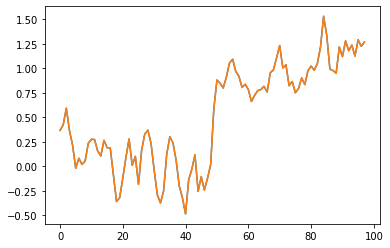

In [ ]:
mean_kernel3 = np.full((3,), 1/3)
print(mean_kernel3)

smooth_signal_3K = np.convolve(noisy_signal, mean_kernel3, mode='valid')

f, ax = plt.subplots()

#ax.plot(step_signal)
#ax.plot(noisy_signal)
#ax.plot(smooth_signal, label = 'mean 2')
ax.plot(smooth_signal_3, label = 'mean 3')
ax.plot(smooth_signal_3K)

np.all(smooth_signal_3K == smooth_signal_3)

In [ ]:
def convolve_demo(signal, kernel):
    ksize = len(kernel)
    convolved = np.correlate(signal, kernel)
    def filter_step(i):
        fig, ax = plt.subplots()
        ax.plot(signal, label='signal')
        ax.plot(convolved[:i+1], label='convolved')
        ax.legend()
        ax.scatter(np.arange(i, i+ksize),
                   signal[i : i+ksize])
        ax.scatter(i, convolved[i])
    return filter_step

from ipywidgets import interact, widgets

i_slider = widgets.IntSlider(min=0, max=len(noisy_signal) - 3,
                             value=0)

interact(convolve_demo(noisy_signal, mean_kernel3),
         i=i_slider);

interactive(children=(IntSlider(value=0, description='i', max=97), Output()), _dom_classes=('widget-interact',…

In [ ]:
mean_kernel11

array([0.09090909, 0.09090909, 0.09090909, 0.09090909, 0.09090909,
       0.09090909, 0.09090909, 0.09090909, 0.09090909, 0.09090909,
       0.09090909])

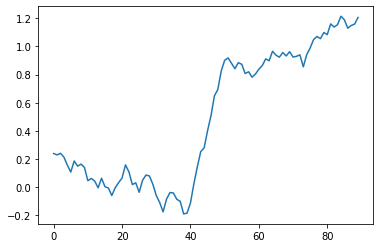

In [ ]:
mean_kernel11 = np.full((11,), 1/11)
smooth_signal11 = np.convolve(noisy_signal, mean_kernel11, mode='valid')

plt.plot(smooth_signal11)

In [ ]:
i_slider = widgets.IntSlider(min=0, max=len(noisy_signal) - 11,
                             value=0)

interact(convolve_demo(noisy_signal, mean_kernel11),
         i=i_slider);

interactive(children=(IntSlider(value=0, description='i', max=89), Output()), _dom_classes=('widget-interact',…

Of course, to take the mean of 11 values, we have to move further and further away from the edges, and this starts to be noticeable. You can use mode='same' to pad the edges of the array and compute a result of the same size as the input:

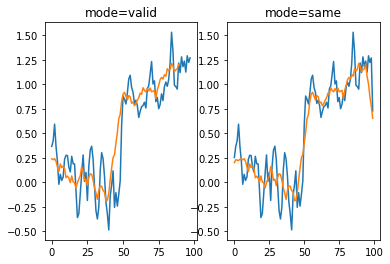

In [ ]:
smooth_signal3same = np.convolve(noisy_signal, mean_kernel3,
                                 mode='same')
smooth_signal11same = np.convolve(noisy_signal, mean_kernel11,
                                  mode='same')

fig, ax = plt.subplots(1, 2)
ax[0].plot(smooth_signal_3K)
ax[0].plot(smooth_signal11)
ax[0].set_title('mode=valid')
ax[1].plot(smooth_signal3same)
ax[1].plot(smooth_signal11same)
ax[1].set_title('mode=same');

In [ ]:
def convolve_demo_same(signal, kernel):
    ksize = len(kernel)
    padded_signal = np.pad(signal, ksize // 2,
                           mode='constant')
    convolved = np.correlate(padded_signal, kernel)
    def filter_step(i):
        fig, ax = plt.subplots()
        x = np.arange(-ksize // 2,
                      len(signal) + ksize // 2)
        ax.plot(signal, label='signal')
        ax.plot(convolved[:i+1], label='convolved')
        ax.legend()
        start, stop = i, i + ksize
        ax.scatter(x[start:stop]+1,
                   padded_signal[start : stop])
        ax.scatter(i, convolved[i])
        ax.set_xlim(-ksize // 2,
                    len(signal) + ksize // 2)
    return filter_step


i_slider = widgets.IntSlider(min=0, max=len(noisy_signal)-1,
                             value=0)

interact(convolve_demo_same(noisy_signal, mean_kernel11),
         i=i_slider);

interactive(children=(IntSlider(value=0, description='i', max=99), Output()), _dom_classes=('widget-interact',…

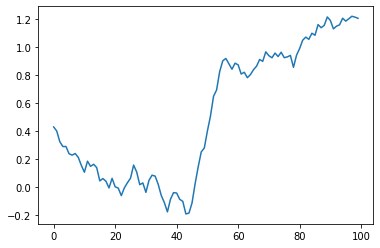

In [ ]:
from scipy import ndimage as ndi

smooth_ndi = ndi.convolve(noisy_signal, mean_kernel11,
                          mode='reflect')

plt.plot(smooth_ndi)

**Exercise:** Can you predict what a convolution with the kernel `[-1, 0, 1]` does? Try thinking about it before running the cells below.

In [ ]:
results_corr = np.correlate(step_signal, np.array([-1, 0, 1]), mode='valid')


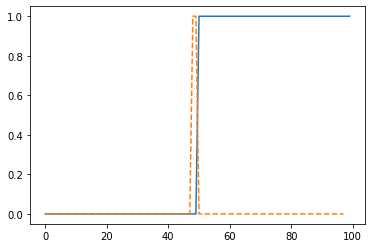

In [ ]:
plt.plot(step_signal)
plt.plot(results_corr, '--')

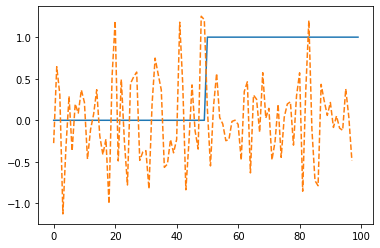

In [ ]:
results_corr = np.correlate(noisy_signal, np.array([-1, 0, 1]), mode='valid')
plt.plot(step_signal)
plt.plot(results_corr, '--')

In [ ]:
mean_diff = np.correlate([-1, 0, 1], [1/3, 1/3, 1/3], mode='full')
print(mean_diff)

[-0.33333333 -0.33333333  0.          0.33333333  0.33333333]


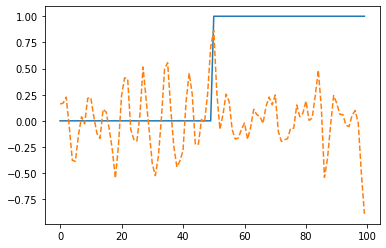

In [ ]:
results_corr = np.correlate(noisy_signal, mean_diff, mode='same')
plt.plot(step_signal)
plt.plot(results_corr, '--')

## Image filtering theory

Filtering is one of the most basic and common image operations in image processing. You can filter an image to remove noise or to enhance features; the filtered image could be the desired result or just a preprocessing step. Regardless, filtering is an important topic to understand.

### Local filtering

In [4]:
import numpy as np
import matplotlib.pyplot as plt

bright_square = np.zeros((7,7), dtype=float)
bright_square[2:5,2:5] = 1

In [5]:
print(bright_square)

[[0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 1. 1. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0.]]


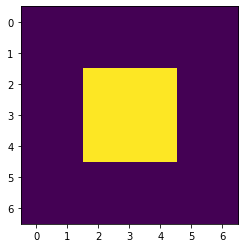

In [6]:
fix, ax = plt.subplots()
ax.imshow(bright_square)


# Mean filter

In [24]:
mean_kernal = np.full((3,3), 1/9.)

print(mean_kernal)

[[0.11 0.11 0.11]
 [0.11 0.11 0.11]
 [0.11 0.11 0.11]]


Applying a (linear) filter essentially means:
* Center a kernel on a pixel
* Multiply the pixels *under* that kernel by the values *in* the kernel
* Sum all the those results
* Replace the center pixel with the summed result

In [16]:
import scipy.ndimage as ndi

%precision 2
print(bright_square)
print(ndi.correlate(bright_square,mean_kernal))

NameError: ignored

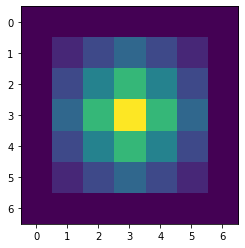

In [13]:
plt.imshow(ndi.correlate(bright_square,mean_kernal))

#### Commutativity and assortativity of filters

## Local filtering of images

Let's see a convolution in action.

(Execute the following cell, but don't try to read it; its purpose is to generate an example.)

In [14]:
#--------------------------------------------------------------------------
#  Convolution Demo
#--------------------------------------------------------------------------
from skimage import color
from scipy import ndimage as ndi
from matplotlib import patches

def mean_filter_demo(image, vmax=1):
    mean_factor = 1.0 / 9.0  # This assumes a 3x3 kernel.
    iter_kernel_and_subimage = iter_kernel(image)

    image_cache = []

    def mean_filter_step(i_step):
        while i_step >= len(image_cache):
            filtered = image if i_step == 0 else image_cache[-1][-1][-1]
            filtered = filtered.copy()

            (i, j), mask, subimage = next(iter_kernel_and_subimage)
            filter_overlay = color.label2rgb(mask, image, bg_label=0,
                                             colors=('cyan', 'red'))
            filtered[i, j] = np.sum(mean_factor * subimage)
            image_cache.append(((i, j), (filter_overlay, filtered)))

        (i, j), images = image_cache[i_step]
        fig, axes = plt.subplots(1, len(images), figsize=(10, 5))
        
        for ax, imc in zip(axes, images):
            ax.imshow(imc, vmax=vmax)
            rect = patches.Rectangle([j - 0.5, i - 0.5], 1, 1, color='yellow', fill=False)
            ax.add_patch(rect)
            
        plt.show()
    return mean_filter_step


def mean_filter_interactive_demo(image):
    from ipywidgets import IntSlider, interact
    mean_filter_step = mean_filter_demo(image)
    step_slider = IntSlider(min=0, max=image.size-1, value=0)
    interact(mean_filter_step, i_step=step_slider)


def iter_kernel(image, size=1):
    """ Yield position, kernel mask, and image for each pixel in the image.

    The kernel mask has a 2 at the center pixel and 1 around it. The actual
    width of the kernel is 2*size + 1.
    """
    width = 2*size + 1
    for (i, j), pixel in iter_pixels(image):
        mask = np.zeros(image.shape, dtype='int16')
        mask[i, j] = 1
        mask = ndi.grey_dilation(mask, size=width)
        #mask[i, j] = 2
        subimage = image[bounded_slice((i, j), image.shape[:2], size=size)]
        yield (i, j), mask, subimage


def iter_pixels(image):
    """ Yield pixel position (row, column) and pixel intensity. """
    height, width = image.shape[:2]
    for i in range(height):
        for j in range(width):
            yield (i, j), image[i, j]


def bounded_slice(center, xy_max, size=1, i_min=0):
    slices = []
    for i, i_max in zip(center, xy_max):
        slices.append(slice(max(i - size, i_min), min(i + size + 1, i_max)))
    return tuple(slices)

In [19]:
# Magic command to make plotting inline
%matplotlib inline

# sets the figure format
%config InlineBackend.figure_format = 'retina'

mean_filter_interactive_demo(bright_square)

interactive(children=(IntSlider(value=0, description='i_step', max=48), Output()), _dom_classes=('widget-inter…

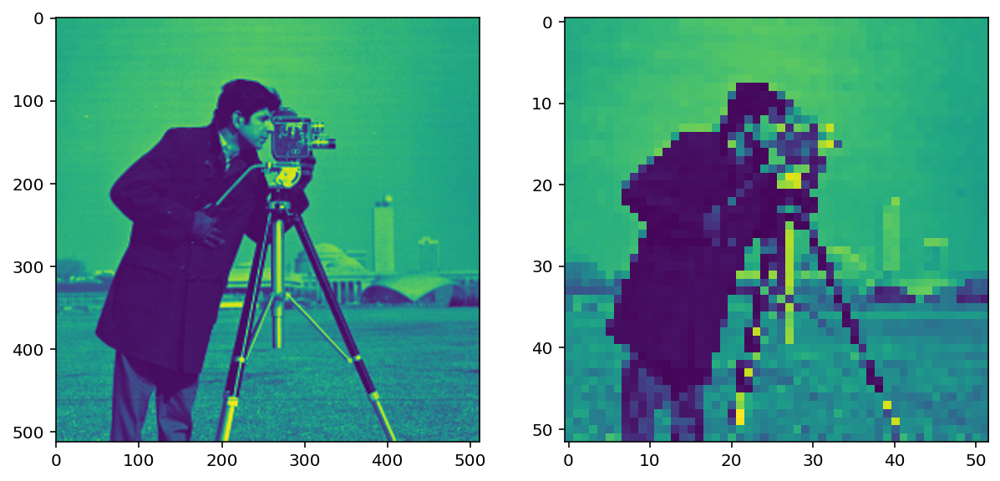

In [20]:
from skimage import data

image = data.camera()
pixelated = image[::10,::10]
fig, (ax0, ax1) = plt.subplots(1,2, figsize=(10,5))
ax0.imshow(image)
ax1.imshow(pixelated)

We are actually going to be using the pattern of plotting multiple images side by side quite often, so we are going to make the following helper function:

In [21]:
from skimage import img_as_float

def imshow_all(*images, titles=None):
    images = [img_as_float(img) for img in images]

    if titles is None:
        titles = [''] * len(images)
    vmin = min(map(np.min, images))
    vmax = max(map(np.max, images))
    ncols = len(images)
    height = 5
    width = height * len(images)
    fig, axes = plt.subplots(nrows=1, ncols=ncols,
                             figsize=(width, height))
    for ax, img, label in zip(axes.ravel(), images, titles):
        ax.imshow(img, vmin=vmin, vmax=vmax)
        ax.set_title(label)


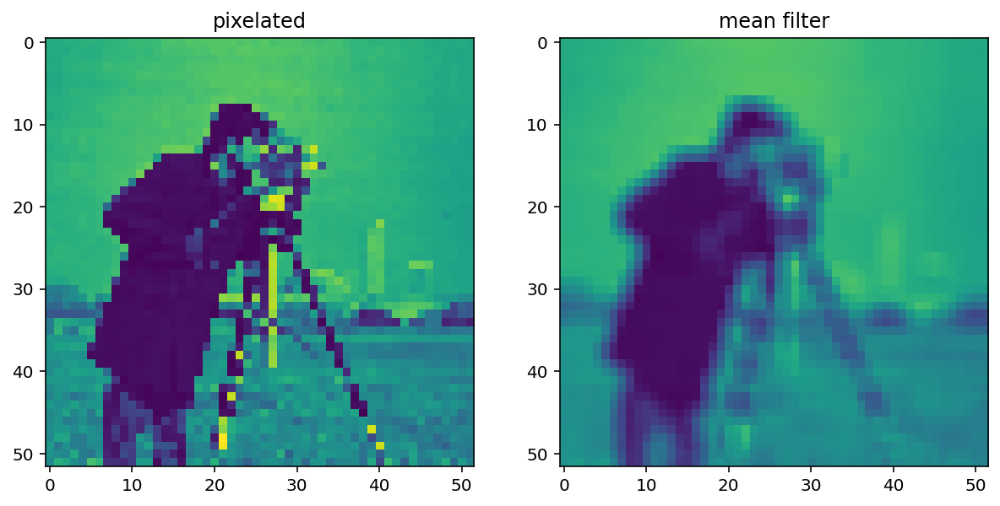

In [22]:
filtered = ndi.correlate(pixelated, mean_kernal)
imshow_all(pixelated, filtered, titles=['pixelated', 'mean filter'])

Comparing the filtered image to the pixelated image, we can see that this filtered result is smoother: Sharp edges (which are just borders between dark and bright pixels) are smoothed because dark pixels reduce the intensity of neighboring pixels and bright pixels do the opposite.

## Essential filters

### Gaussian filter

The classic image filter is the Gaussian filter. This is similar to the mean filter, in that it tends to smooth images. The Gaussian filter, however, doesn't weight all values in the neighborhood equally. Instead, pixels closer to the center are weighted more than those farther away.

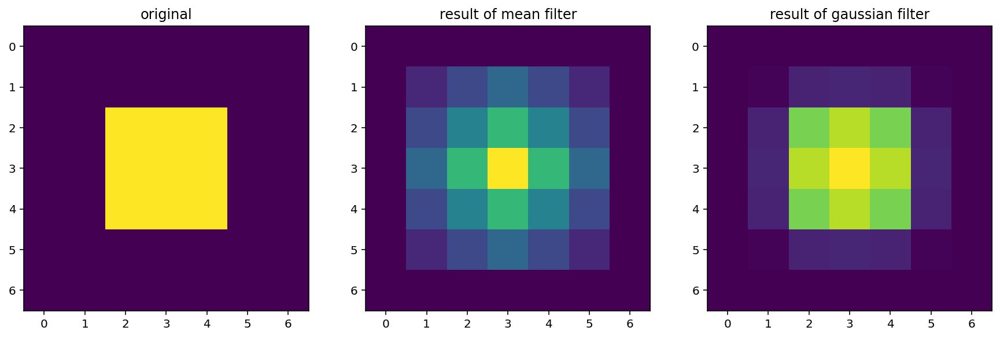

In [29]:
# Rename module so we don't shadow the builtin function
from skimage import filters

smooth_mean = ndi.correlate(bright_square, mean_kernal)
sigma = .5
smooth = filters.gaussian(bright_square, sigma)
imshow_all(bright_square, smooth_mean, smooth,
           titles=['original', 'result of mean filter', 'result of gaussian filter'])

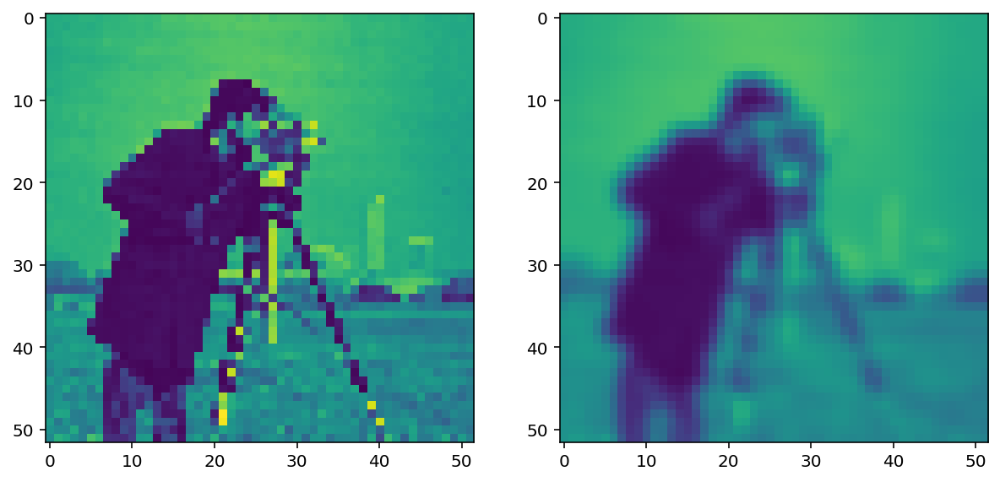

In [46]:
from skimage import img_as_float

pixelated_float = img_as_float(pixelated)
smooth = filters.gaussian(pixelated_float, sigma=1)
imshow_all(pixelated, smooth)

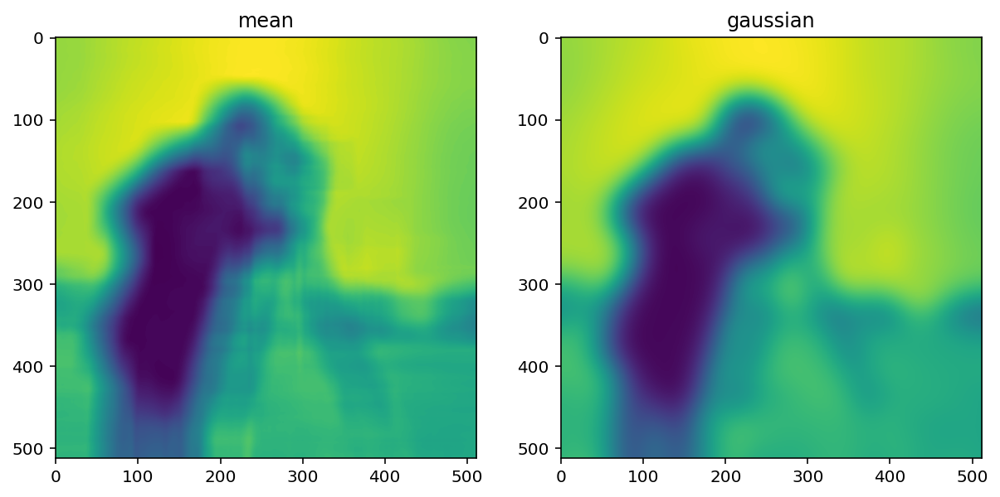

In [32]:
size = 20
structuring_element = np.ones((3*size, 3*size))
smooth_mean = filters.rank.mean(image, structuring_element)
smooth_gaussian = filters.gaussian(image, size)
titles = ['mean', 'gaussian']
imshow_all(smooth_mean, smooth_gaussian, titles=titles)

### Basic edge filtering

#### Difference filters in 2D

In [36]:
vertical_kernel = np.array([
                            [1],
                            [0],
                            [-1],
])



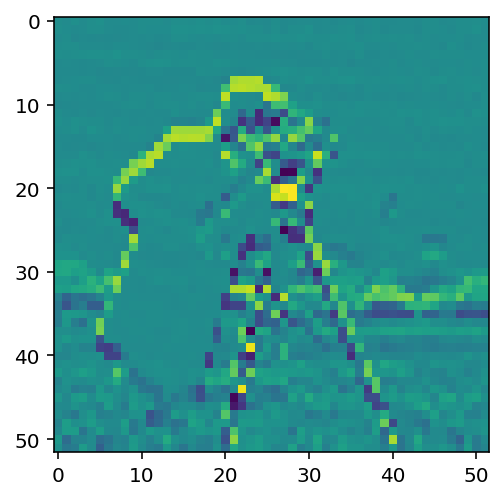

In [37]:
gradient_vertical = ndi.correlate(pixelated_float, vertical_kernel)

fig, ax = plt.subplots()
ax.imshow(gradient_vertical)

The Sobel filter, the most commonly used edge filter.
* http://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.sobel_v
* http://scikit-image.org/docs/dev/api/skimage.filters.html#skimage.filters.sobel_h

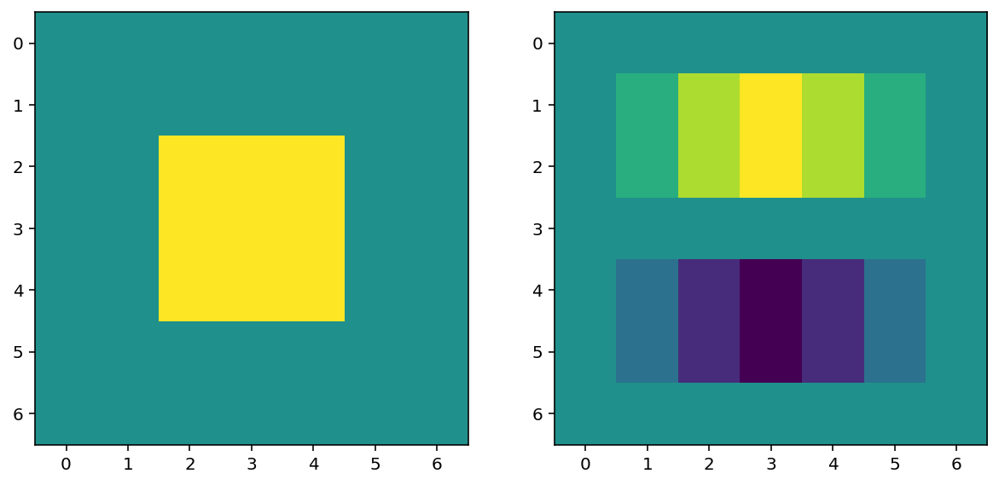

In [41]:
imshow_all(bright_square, filters.sobel_h(bright_square))

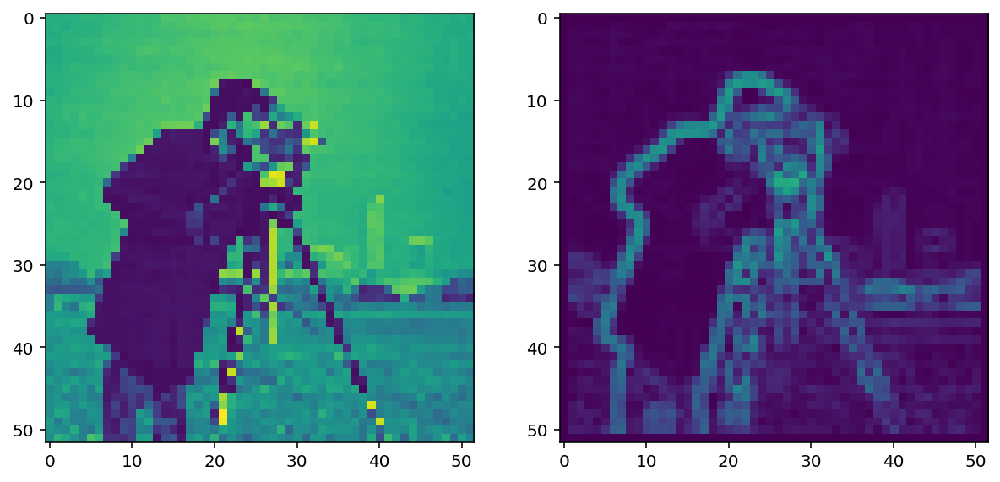

In [42]:
pixelated_gradient = filters.sobel(pixelated)
imshow_all(pixelated, pixelated_gradient)

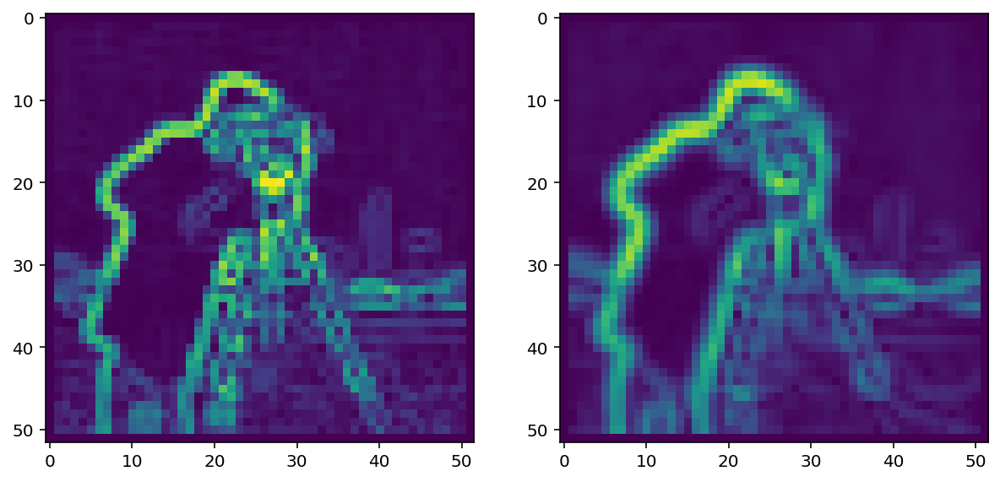

In [47]:
gradient = filters.sobel(smooth)
imshow_all(pixelated_gradient, gradient*1.8)

## Denoising filters

### Median Filter

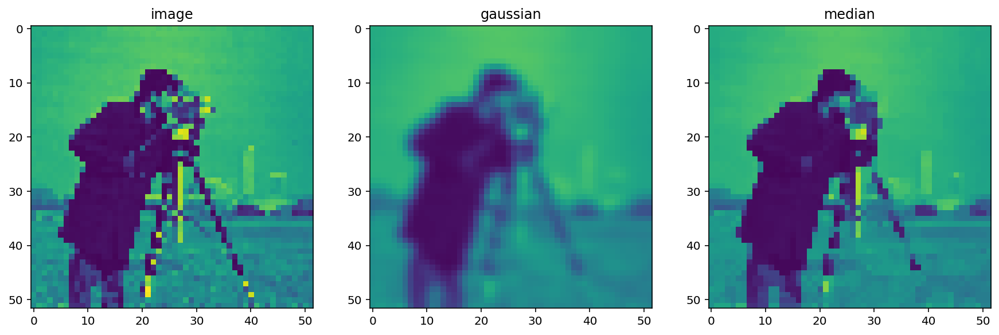

In [48]:
from skimage.morphology import disk
neighborhood = disk(radius=1)  # "selem" is often the name used for "structuring element"
median = filters.rank.median(pixelated, neighborhood)
titles = ['image', 'gaussian', 'median']
imshow_all(pixelated, smooth, median, titles=titles)

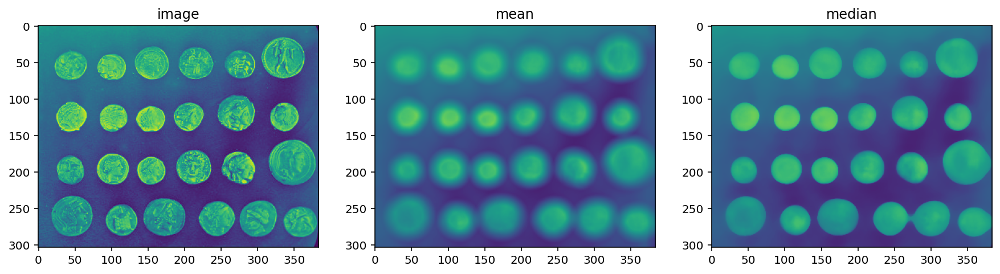

In [49]:
neighborhood = disk(10)
coins = data.coins()
mean_coin = filters.rank.mean(coins, neighborhood)
median_coin = filters.rank.median(coins, neighborhood)
titles = ['image', 'mean', 'median']
imshow_all(coins, mean_coin, median_coin, titles=titles)

## Further reading

# Feature detection

## Edge detection

### Canny edge detector

## Hough transforms

### Circle detection

## Further reading

* [Probabilistic Hough transform](http://scikit-image.org/docs/dev/auto_examples/plot_line_hough_transform.html)
* [Circular and elliptical Hough transforms](http://scikit-image.org/docs/dev/auto_examples/plot_circular_elliptical_hough_transform.html)
* [Template matching](http://scikit-image.org/docs/dev/auto_examples/plot_template.html)
* [Histogram of Oriented Gradients](http://scikit-image.org/docs/dev/auto_examples/plot_hog.html)
* [BRIEF](http://scikit-image.org/docs/dev/auto_examples/plot_brief.html), [CENSURE](http://scikit-image.org/docs/dev/auto_examples/plot_censure.html), and [ORB](http://scikit-image.org/docs/dev/auto_examples/plot_orb.html) feature detectors/descriptors
* [Robust matching using RANSAC](http://scikit-image.org/docs/dev/auto_examples/plot_matching.html)

# Diatom analysis

See https://www.nature.com/articles/s41524-019-0202-3:

**Deep data analytics for genetic engineering of diatoms linking genotype to phenotype via machine learning**, Artem A. Trofimov, Alison A. Pawlicki, Nikolay Borodinov, Shovon Mandal, Teresa J. Mathews, Mark Hildebrand, Maxim A. Ziatdinov, Katherine A. Hausladen, Paulina K. Urbanowicz, Chad A. Steed, Anton V. Ievlev, Alex Belianinov, Joshua K. Michener, Rama Vasudevan, and Olga S. Ovchinnikova.

In [17]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [18]:
import matplotlib

matplotlib.rcParams.update({
    'figure.figsize': (10,10),
    'image.cmap': 'gray'

})

In [19]:
!pip install wget

In [20]:
import wget

wget.download('https://github.com/jagar2/Summer_2020_MAT-395-495_Scientific-Data-Analysis-and-Computing/blob/master/lectures/5_Image_Analysis/data/diatom-wild-032.jpg?raw=True')

'diatom-wild-032 (1).jpg'

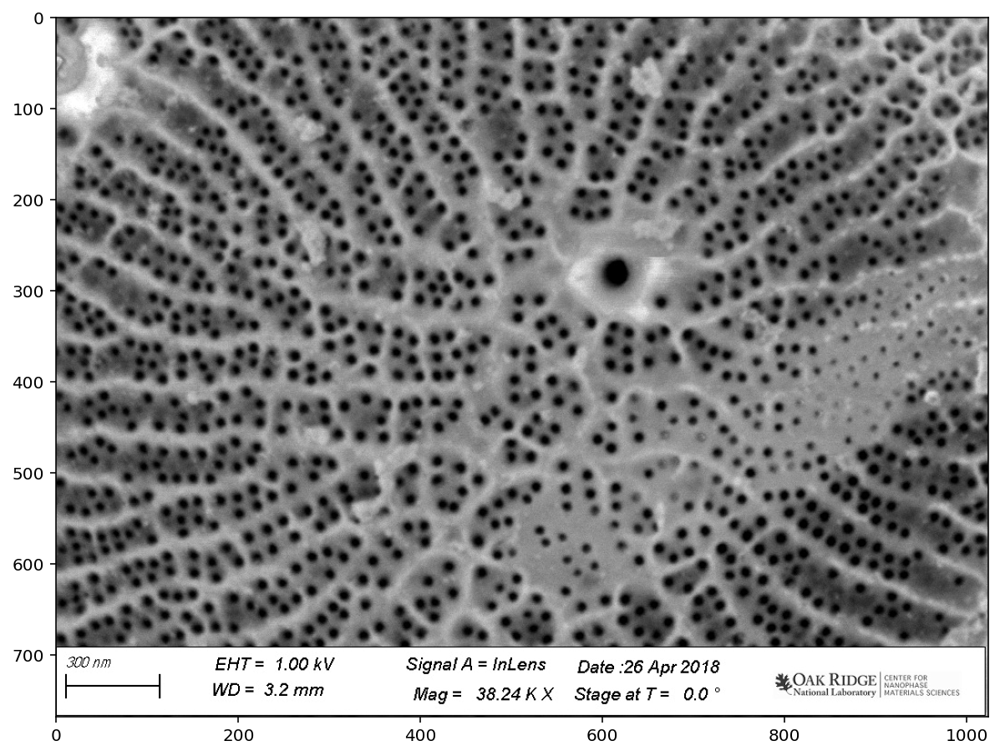

In [21]:
from skimage import io
image = io.imread('./diatom-wild-032.jpg')

plt.imshow(image)

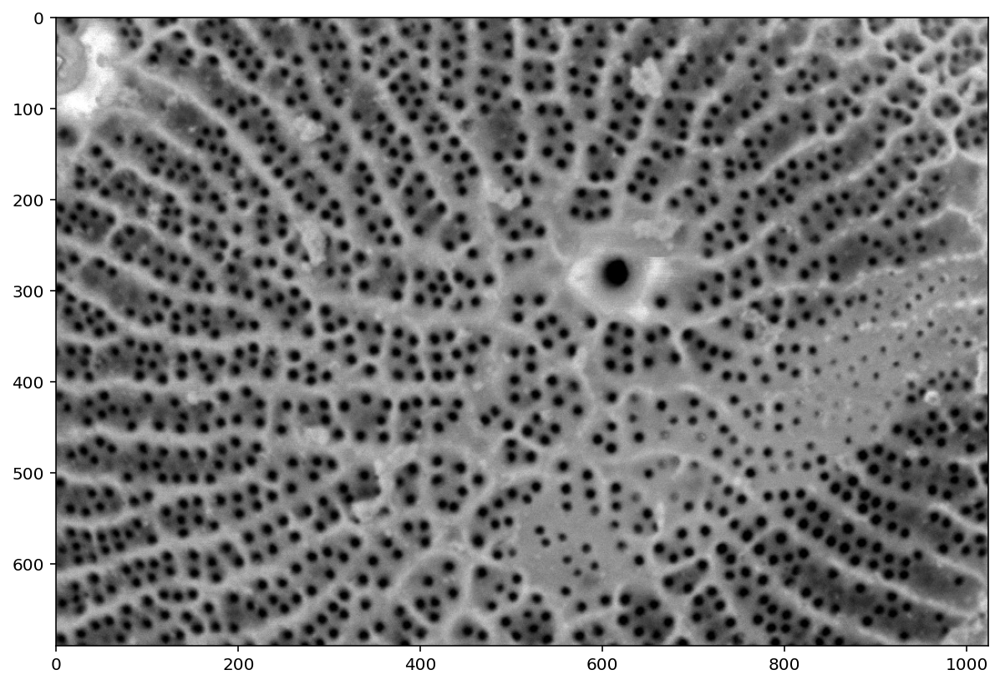

In [24]:
pores = image[:690,:]

plt.imshow(pores)

In [25]:
from skimage.util import img_as_float
denoised = ndi.median_filter(img_as_float(pores), size=3)

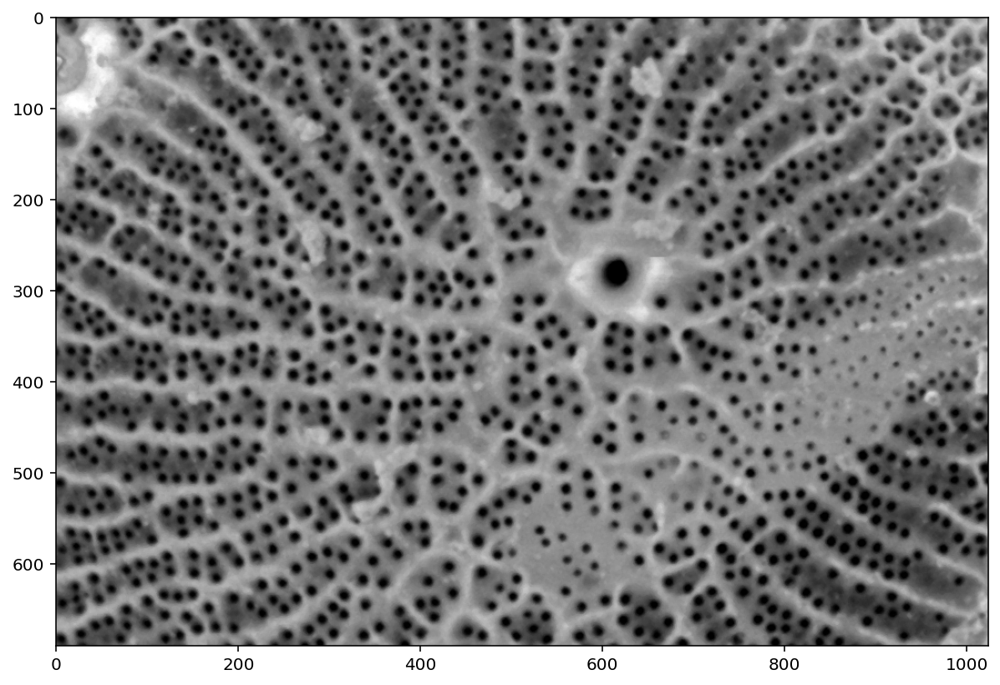

In [26]:
plt.imshow(denoised)

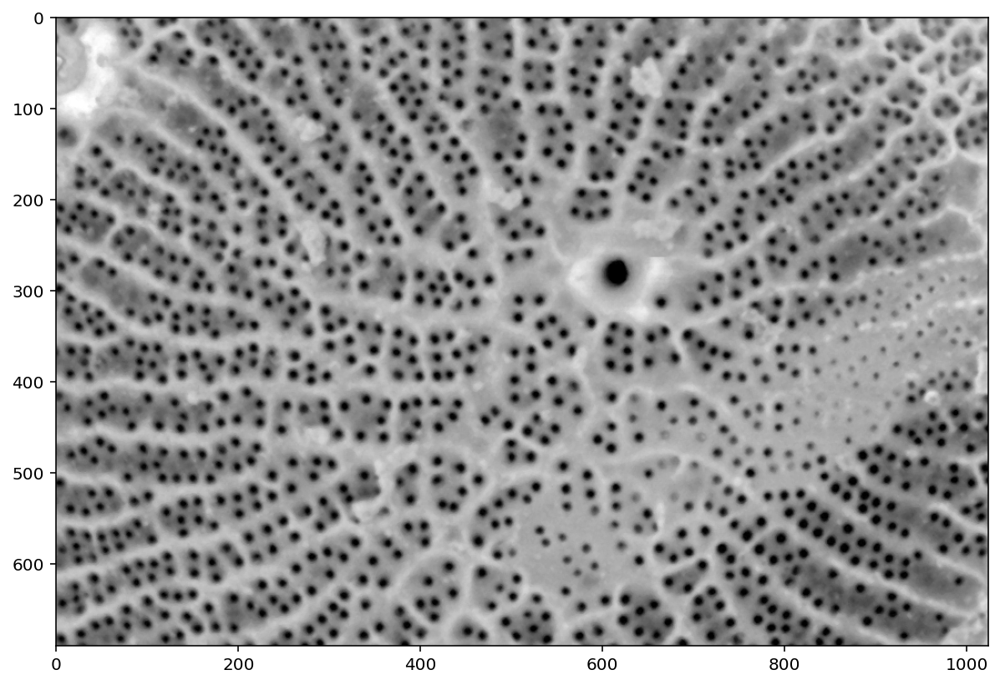

In [27]:
from skimage import exposure

pores_gamma = exposure.adjust_gamma(denoised, 0.7)
plt.imshow(pores_gamma)

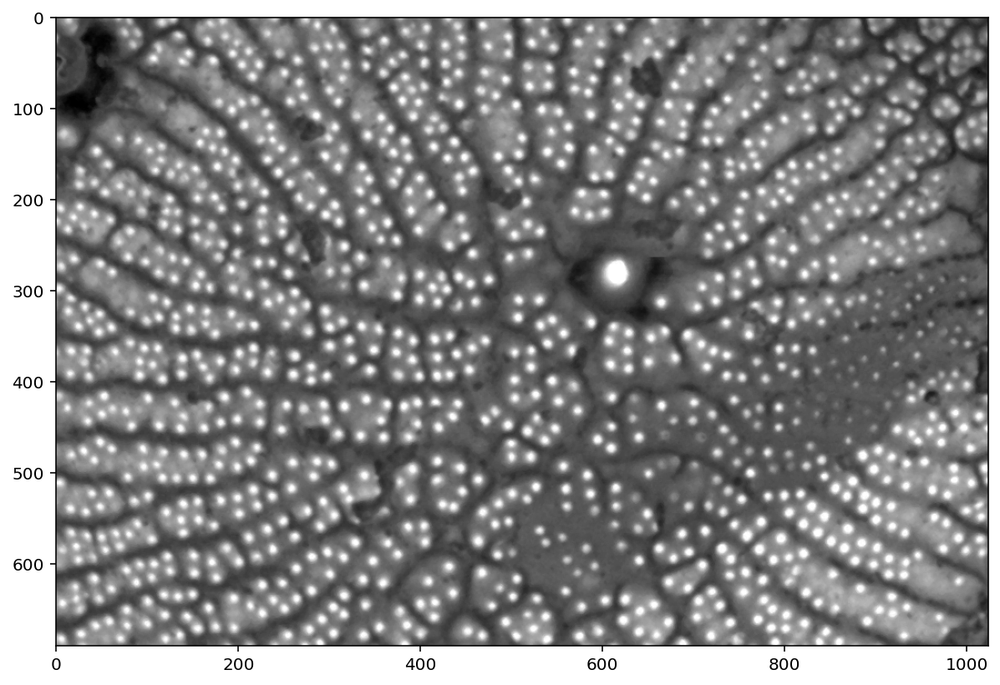

In [28]:
pores_inv = 1 - pores_gamma
plt.imshow(pores_inv)

(array([ 5244.,     0.,  3891.,  2596.,  1954.,  1458.,  1237.,  1118.,
         2311.,  1100.,  1183.,  2323.,  1138.,  2358.,  1209.,  2481.,
         2410.,  2546.,  1194.,  2541.,  2525.,  2505.,  2723.,  2835.,
         2784.,  2883.,  2873.,  3075.,  3092.,  3345.,  3377.,  5430.,
         3802.,  4099.,  4266.,  7202.,  5280.,  8433.,  6326.,  6483.,
        10528.,  7548., 11893.,  8478., 13077., 13945.,  9641., 13863.,
        13847.,  9596., 14108., 13883.,  9401., 13733., 14334., 14474.,
        14641., 14979., 15367., 10867., 16524., 17533., 18852., 20609.,
        22189., 23574., 24528., 24784., 28765., 18844., 17674., 16285.,
        15016., 14199., 16042.,  9081.,  6858.,  5155.,  4841.,  2546.,
         1989.,  1973.,  1052.,   829.,   827.,   412.,   334.,   490.,
          282.,   375.,   241.,   291.,   200.,   233.,   204.,   246.,
          237.,   199.,   188.,   226.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 

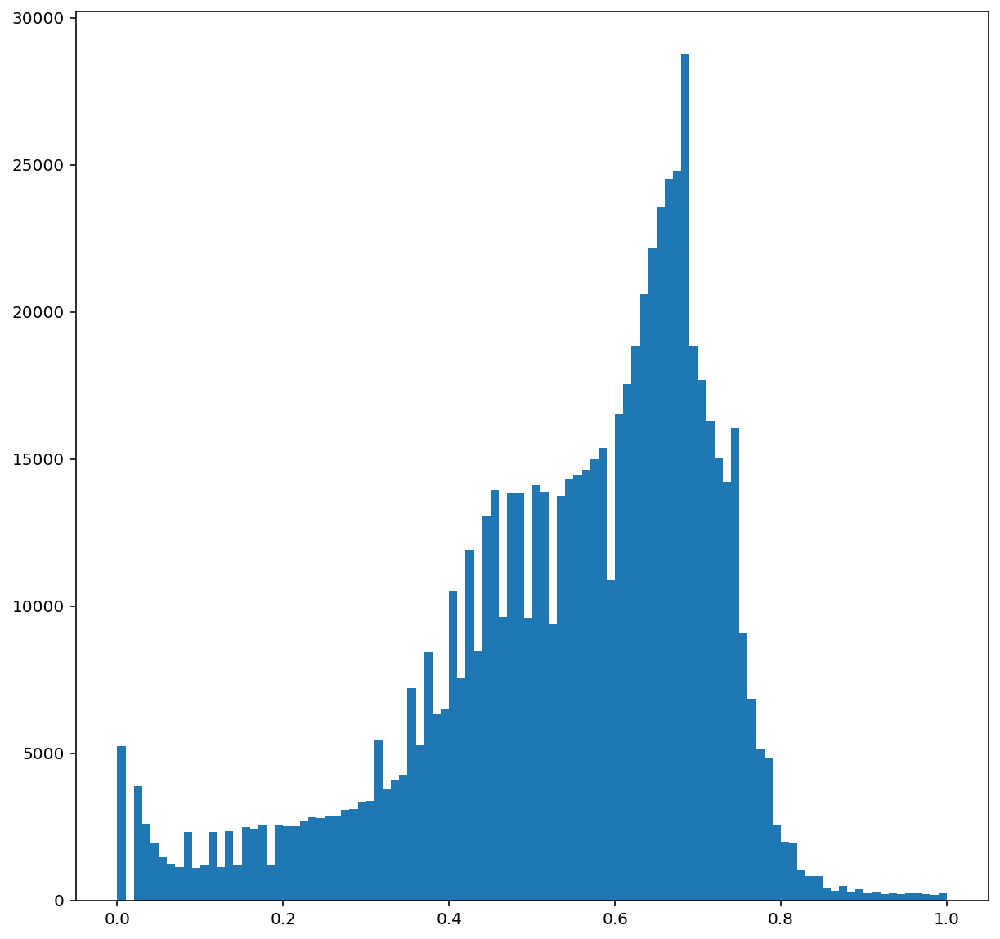

In [34]:
plt.hist(pores_gamma.reshape(-1), 100)

(array([  226.,   188.,   199.,   237.,   246.,   204.,   233.,   200.,
          291.,   241.,   375.,   282.,   490.,   334.,   412.,   827.,
          829.,  1052.,  1973.,  1989.,  2546.,  4841.,  5155.,  6858.,
         9081., 16042., 14199., 15016., 16285., 17674., 18844., 28765.,
        24784., 24528., 23574., 22189., 20609., 18852., 17533., 16524.,
        10867., 15367., 14979., 14641., 14474., 14334., 13733.,  9401.,
        13883., 14108.,  9596., 13847., 13863.,  9641., 13945., 13077.,
         8478., 11893.,  7548., 10528.,  6483.,  6326.,  8433.,  5280.,
         7202.,  4266.,  4099.,  3802.,  5430.,  3377.,  3345.,  3092.,
         3075.,  2873.,  2883.,  2784.,  2835.,  2723.,  2505.,  2525.,
         2541.,  1194.,  2546.,  2410.,  2481.,  1209.,  2358.,  1138.,
         2323.,  1183.,  1100.,  2311.,  1118.,  1237.,  1458.,  1954.,
         2596.,  3891.,     0.,  5244.]),
 array([0.  , 0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.07, 0.08, 0.09, 0.1 ,
        0.11, 0.12, 

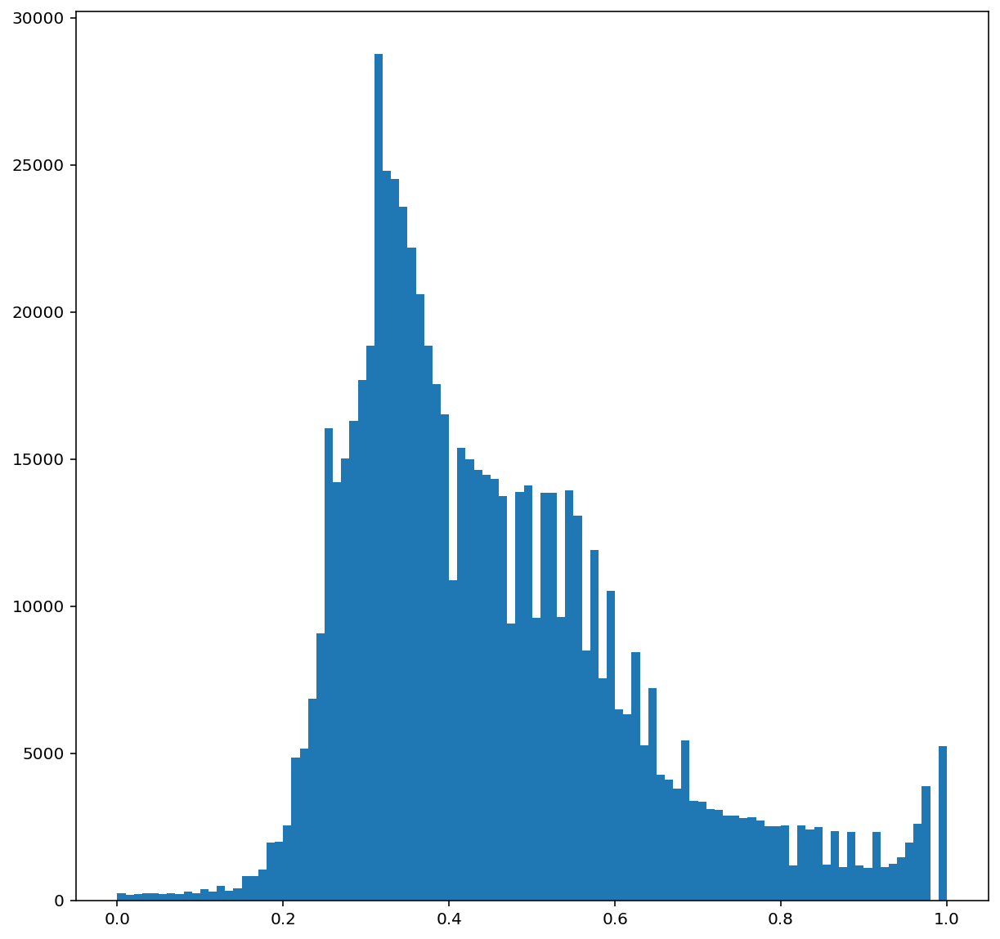

In [35]:
plt.hist(pores_inv.reshape(-1), 100)

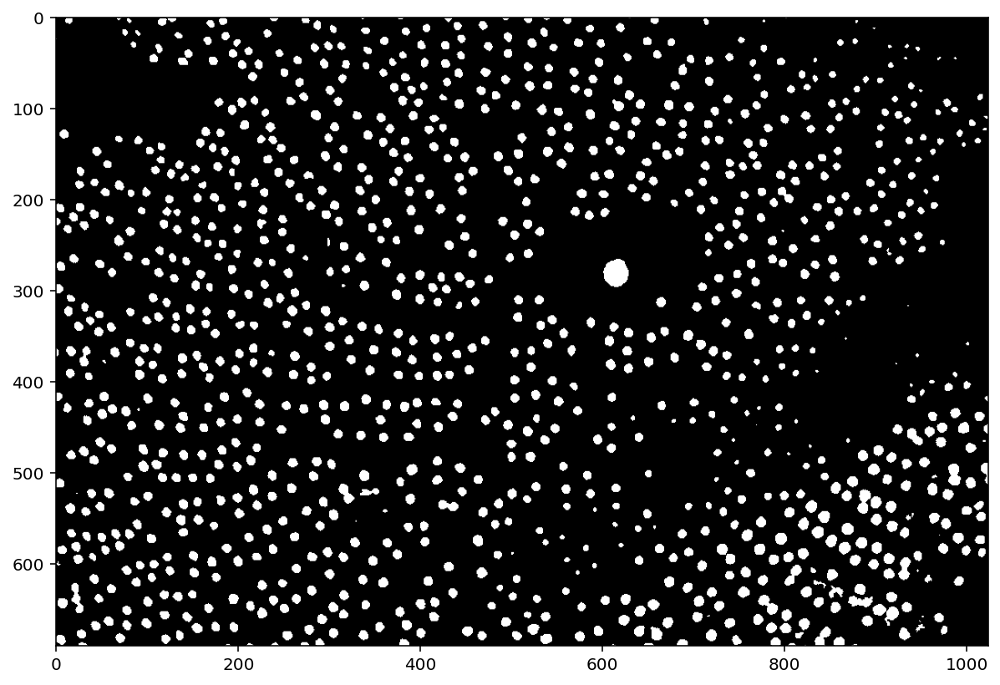

In [31]:
t = 0.325
thresholded = (pores_gamma <= t)

plt.imshow(thresholded)

skimage.filters.thresholding.threshold_isodata
skimage.filters.thresholding.threshold_li
skimage.filters.thresholding.threshold_mean
skimage.filters.thresholding.threshold_minimum
skimage.filters.thresholding.threshold_otsu
skimage.filters.thresholding.threshold_triangle
skimage.filters.thresholding.threshold_yen


(<Figure size 1080x1080 with 8 Axes>,
 array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f8a5a204438>,
       dtype=object))

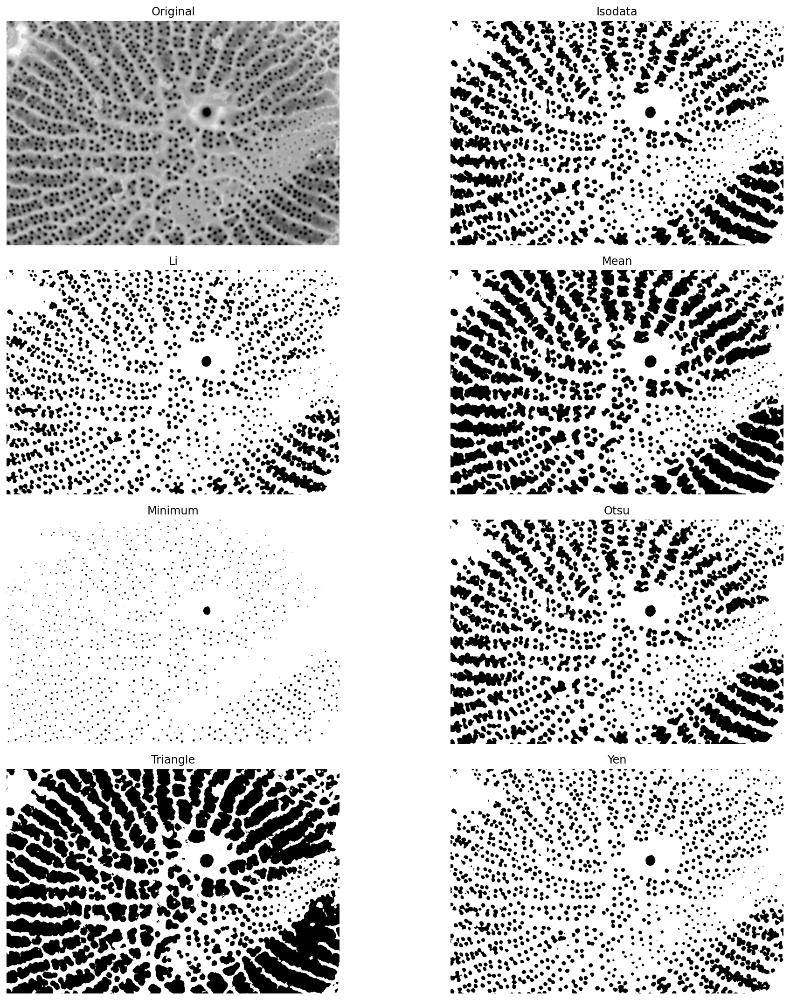

In [38]:
from skimage import filters

filters.try_all_threshold(pores_gamma, figsize=(15,15))

In [39]:
from skimage import segmentation, morphology, color

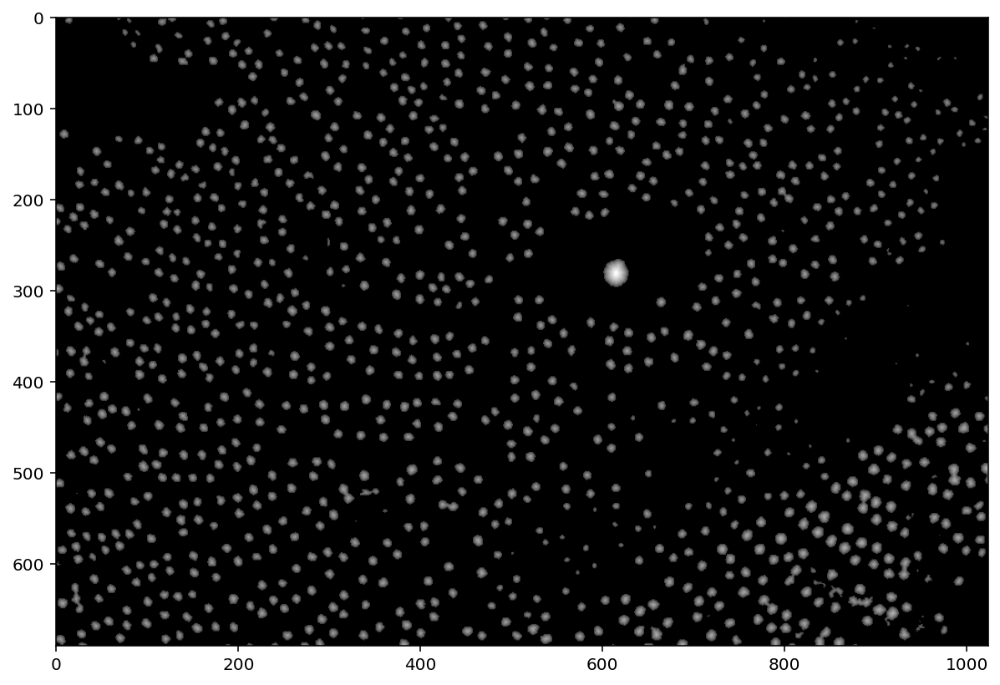

In [41]:
distance = ndi.distance_transform_edt(thresholded)

plt.imshow(exposure.adjust_gamma(distance, 0.5))

In [42]:
local_maximum = morphology.local_maxima(distance)

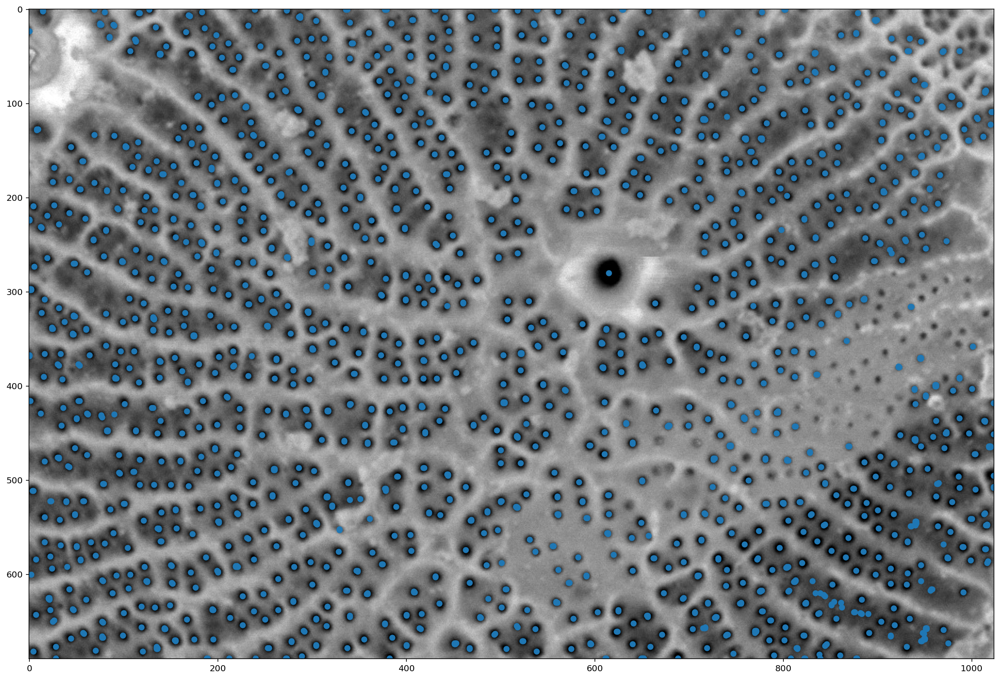

In [43]:
fig, ax = plt.subplots(figsize=(20,20))

max_coords = np.nonzero(local_maximum)

ax.imshow(pores)
plt.scatter(max_coords[1],max_coords[0])

In [47]:
local_maxima = morphology.local_maxima(distance)
markers = ndi.label(local_maxima)[0]

label_masked = segmentation.watershed(thresholded, markers, mask=thresholded, connectivity=2)

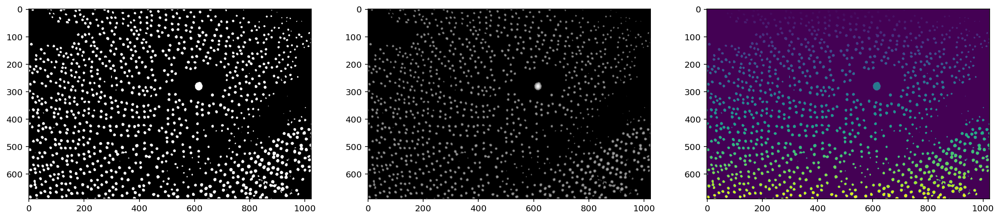

In [53]:
f, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(20, 5))
ax0.imshow(thresholded)
ax1.imshow(np.log(1 + distance))
ax2.imshow(label_masked, cmap='viridis');

In [52]:
label_masked.shape

(690, 1024)

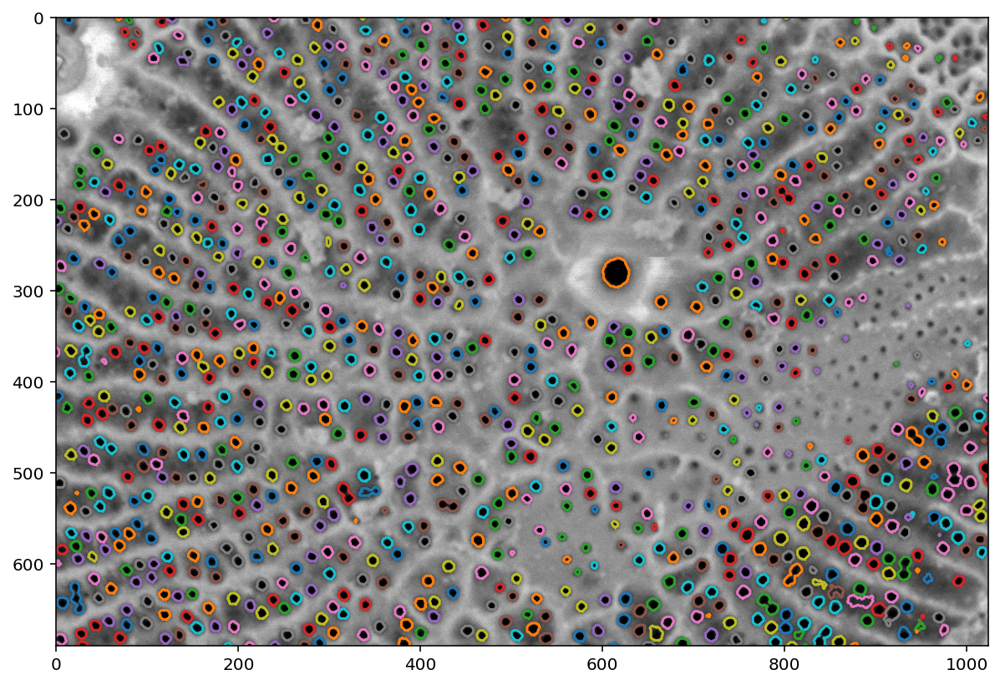

In [55]:
from skimage import measure

contours = measure.find_contours(label_masked, level=0.5)
plt.imshow(pores)
for c in contours:
    plt.plot(c[:, 1], c[:, 0])

In [57]:
regions = measure.regionprops(label_masked)

In [63]:
regions[0].area

46

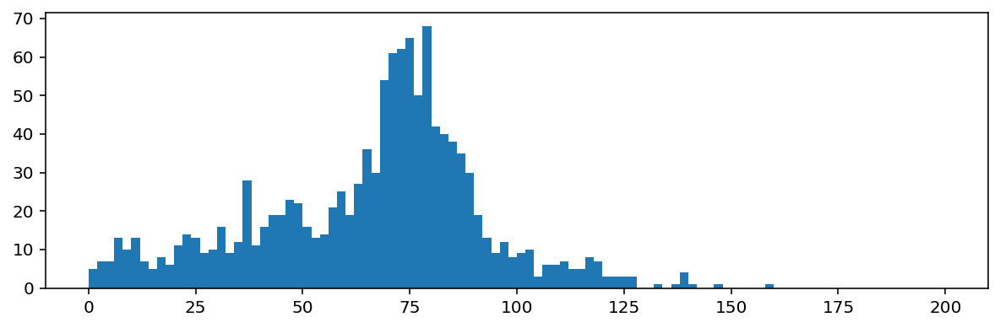

In [64]:
f, ax = plt.subplots(figsize=(10, 3))
ax.hist([r.area for r in regions], bins=100, range=(0, 200));